In [1]:
%reload_ext autoreload
%autoreload 2

from help_function import *
from RLE_handler_mod import _rle_decode_frame_mod, _parse_rle_header, _rle_decode_segment
import pydicom as dicom
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import os
from shutil import copyfile
import cv2
import pandas as pd
import csv
import numpy as np
import IPython
import math
import copy
from timeit import default_timer as timer
import datetime
from PIL import Image
from IPython.display import Image as gifShow


## Check if images converted with edited RLE function are good as images manually imported

In [2]:
metadata = pd.read_csv('./sacco/Clip_MetaData.csv')

In [3]:
# edit function

original_function = copy.deepcopy(dicom.pixel_data_handlers.rle_handler._rle_decode_frame)
dicom.pixel_data_handlers.rle_handler._rle_decode_frame = _rle_decode_frame_mod



#### Convert images with Import_Status == 'Failed'

In [4]:
input_folder = './sacco/'
output_folder = './sacco/PNG/Check'


metadata = pd.read_csv('./sacco/Clip_MetaData.csv')
metadata_by_frame = convert_DICOM(metadata_df=metadata[metadata.Import_Status == 'Failed'],
                                  input_folder=input_folder,
                                  output_folder=output_folder)

# metadata_by_frame.to_csv('./sacco/Frame_MetaData.csv', index=False)

1 / 55
 warning, PhotometricInterpretation is YBR_FULL
2 / 55
 warning, PhotometricInterpretation is YBR_FULL
3 / 55
 warning, PhotometricInterpretation is YBR_FULL
4 / 55
 warning, PhotometricInterpretation is YBR_FULL
5 / 55
 warning, PhotometricInterpretation is YBR_FULL
6 / 55
 warning, PhotometricInterpretation is YBR_FULL
7 / 55
 warning, PhotometricInterpretation is YBR_FULL
8 / 55
 warning, PhotometricInterpretation is YBR_FULL
9 / 55
 warning, PhotometricInterpretation is YBR_FULL
10 / 55
 warning, PhotometricInterpretation is YBR_FULL
11 / 55
 warning, PhotometricInterpretation is YBR_FULL
12 / 55
 warning, PhotometricInterpretation is YBR_FULL
13 / 55
 warning, PhotometricInterpretation is YBR_FULL
14 / 55
 warning, PhotometricInterpretation is YBR_FULL
15 / 55
 warning, PhotometricInterpretation is YBR_FULL
16 / 55
 warning, PhotometricInterpretation is YBR_FULL
17 / 55
 warning, PhotometricInterpretation is YBR_FULL
18 / 55
 warning, PhotometricInterpretation is YBR_FULL
1

#### Compare frames with manually converted

/home/alessandro/.local/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


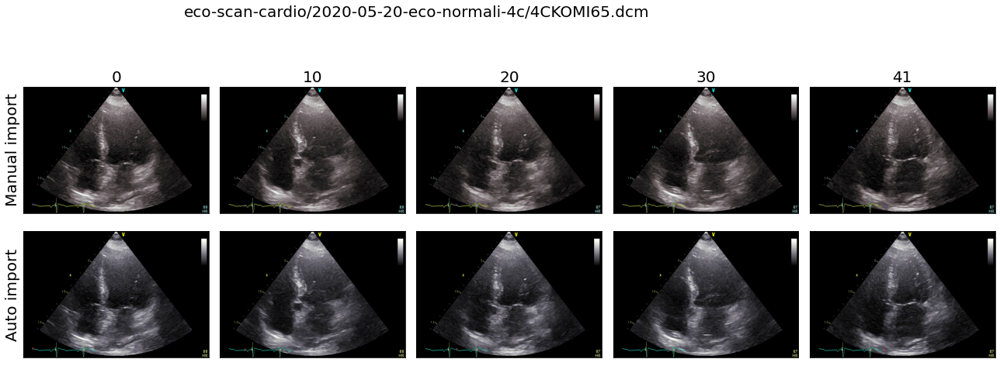

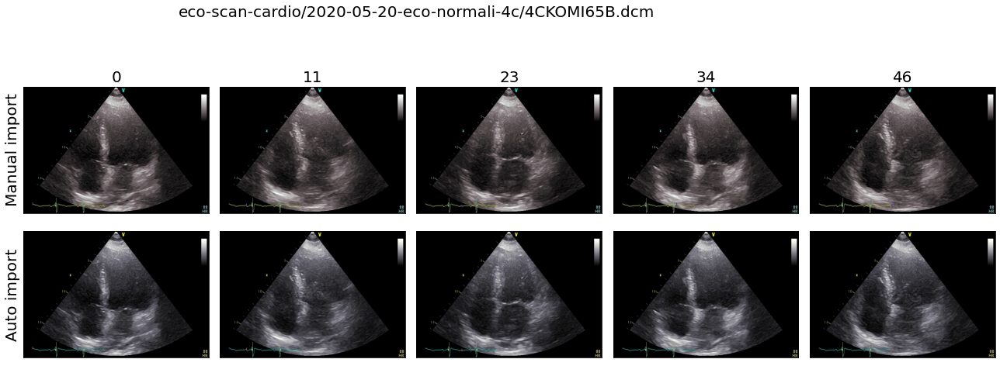

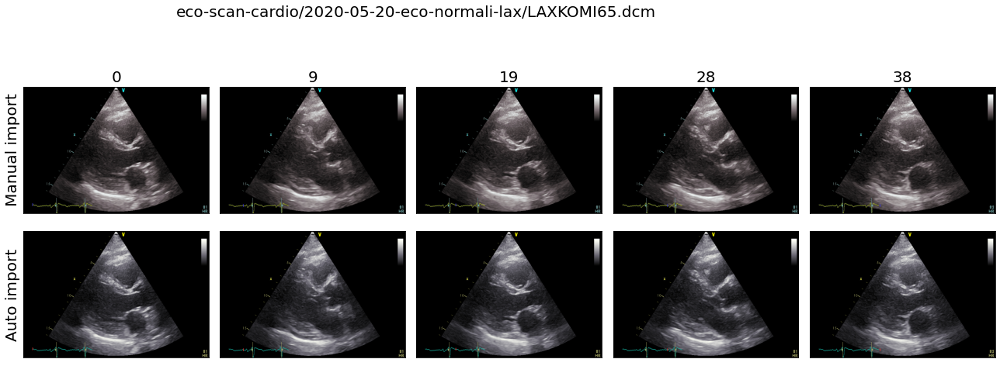

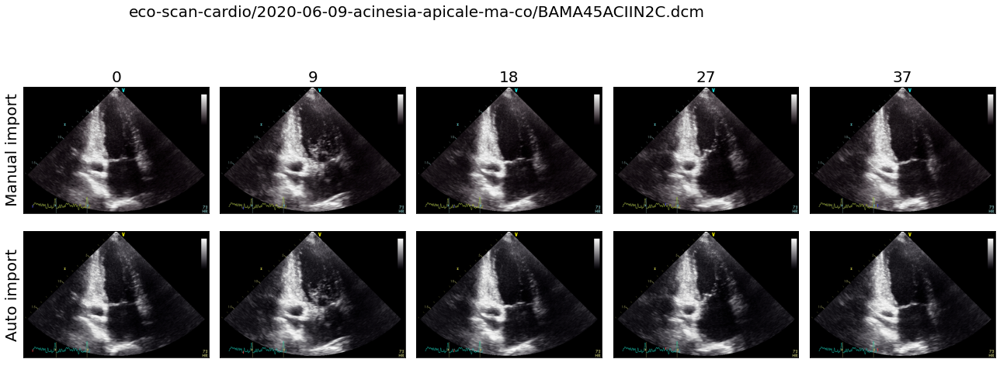

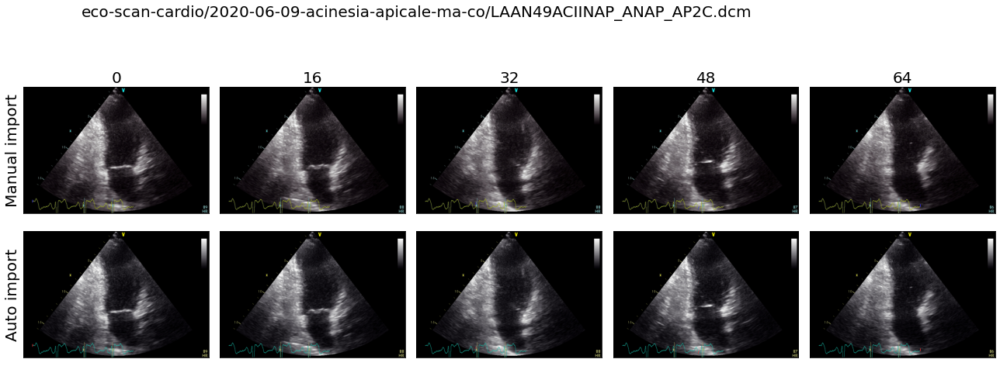

...

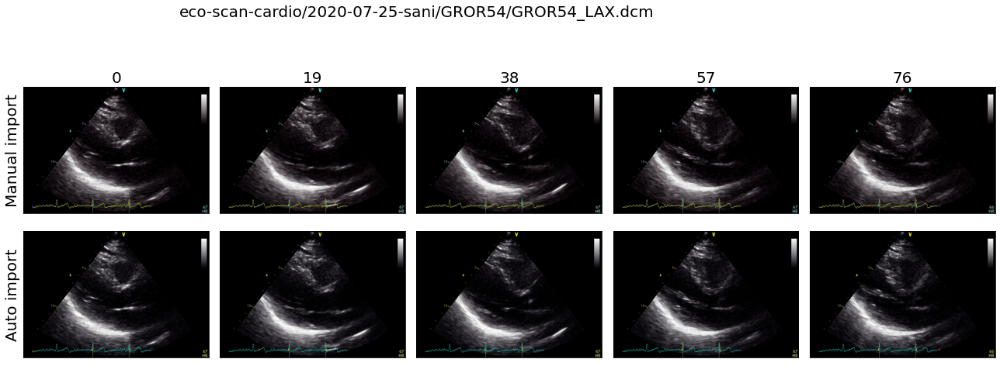

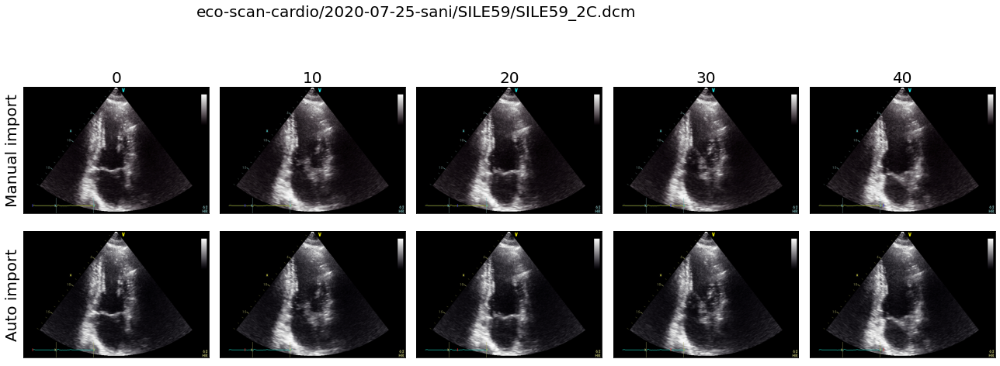

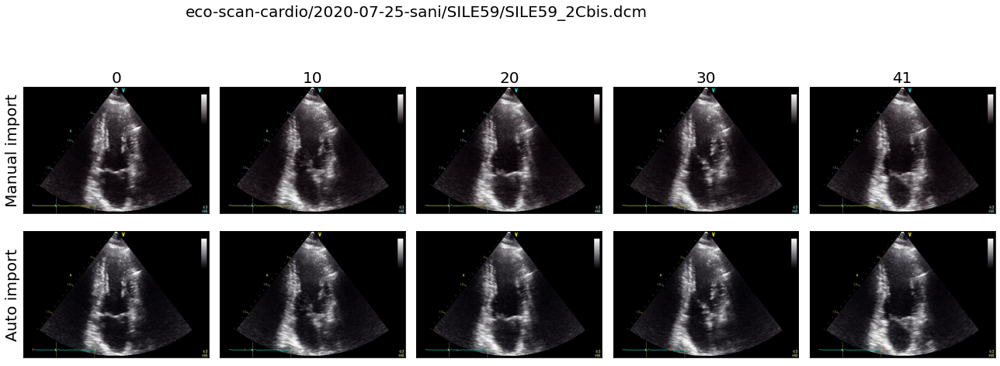

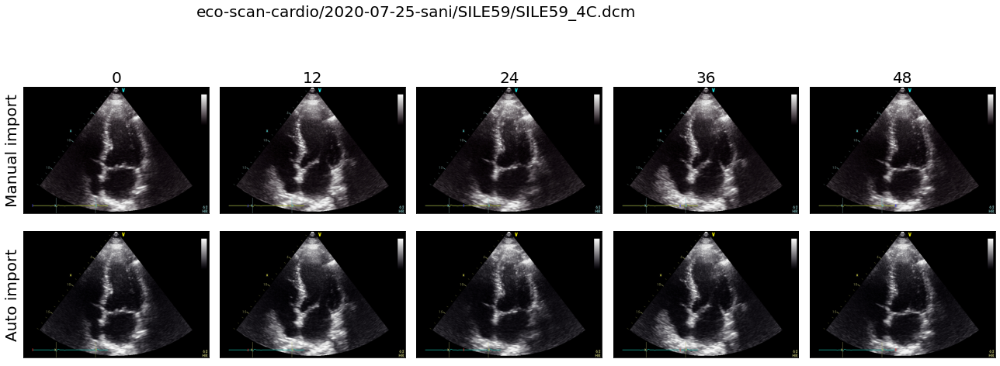

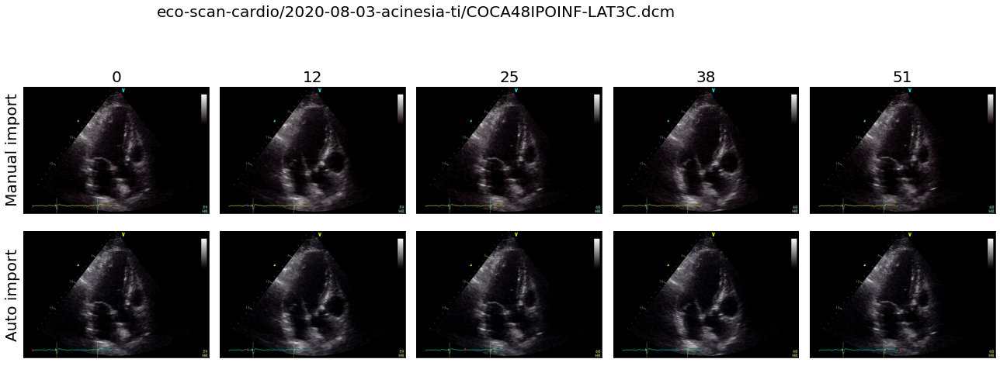

In [6]:
save_folder = './sacco/sample_and_check/check_failed_import'
fig_x_size = 15
sample_per_row = 5

# fig_y_size = fig_x_size / 2 * len(metadata_by_frame.filename.nunique())
# fig, ax = plt.subplots(metadata_by_frame.filename.nunique(), sample_per_row, figsize=(fig_x_size, fig_y_size),
#                        sharey=False, sharex=False)
# ax = ax.flatten()

_=os.makedirs(save_folder, exist_ok=True)
fig_list=[]
for filename in metadata_by_frame.filename.unique():
    
    frame_df = metadata_by_frame[metadata_by_frame.filename == filename].sort_values(by=['Frame_ID'])
    tot_frames = frame_df.NumberOfFrames.values[0]
    frame_to_plot = np.linspace(0, tot_frames-1, sample_per_row).astype(int)
    if 0 not in frame_to_plot or (tot_frames-1) not in frame_to_plot:
        print(filename, 'skipped first or last frame')
    
    fig, ax = plt.subplots(2, sample_per_row, figsize=(fig_x_size, fig_x_size /2),
                       sharey=False, sharex=False)
    ax = ax.flatten()
    
    
    for i, frame in enumerate(frame_to_plot):
        frame_path_check = frame_df.index_frame.values[frame]
        frame_path_manual = frame_path_check.replace('Check', 'Converted')
        
        img_check = cv2.imread(frame_path_check)
        img_manual = cv2.imread(frame_path_manual)

        ax[i].imshow(img_manual)
        ax[i].set_xticks([])
        ax[i].set_yticks([])
        ax[i+sample_per_row].imshow(img_check)
        ax[i+sample_per_row].set_xticks([])
        ax[i+sample_per_row].set_yticks([])
        ax[i].set_title(frame, size = 20)
        if i == 0:
            ax[i].set_ylabel('Manual import', size = 20)
            ax[i+sample_per_row].set_ylabel('Auto import', size = 20)
            
#     fig.text(0.5, 0.9, frame_df['index'].unique()[0], horizontalalignment='center', size = 20)
    fig.suptitle(frame_df['index'].unique()[0], size = 20)
    fig.tight_layout(rect=[0, 0.03, 1.2, 0.95])
    
    fig_path = os.path.join(save_folder, filename+'.png')
    fig_list.append(fig_path)
    fig.savefig(fig_path, bbox_inches="tight")
    
get_concat_v([Image.open(x) for x in fig_list]).save(os.path.join(save_folder, '000_All.png'), bbox_inches="tight")